# Clusterização de ensaios de amaciamento

Este script...

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from sklearn.cluster import KMeans
import numpy as np
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.cluster import DBSCAN
from matplotlib import pyplot

# Funções

## Tratamento


In [2]:
def cria_colunas_espacadas(amostra: pd.DataFrame, M_janela: int, N_features: int, D_espacamento: list[int]):
    
  for d in D_espacamento:
    for n in range(1,N_features):
      amostra[f'{M_janela}(K-{d*n})'] = amostra[f'{M_janela}'].shift(d*n)

  return amostra

In [3]:
def trata_amostras_varios(amostra: pd.DataFrame, n_ensaio:int, grandeza: str, M_janela: list[int], N_features: int, D_espacamento: list[int], tempoMax: int, tempoMin:int = 1):
  
  '''Selecionando a tabela passada a função as colunas: Tempo e o Nome da colunas a ser tratada'''
  dados_espacados = amostra[['Tempo', grandeza]].copy()
  dados_espacados['Ensaio'] = n_ensaio

  '''selecionando apenas as linhas onde o tempo de início é maior que 0 e menor que o tempo selecionado ao chamar a função'''
  dados_espacados = dados_espacados[(dados_espacados.Tempo<=tempoMax) & (dados_espacados.Tempo>=tempoMin)]

  '''retirando linhas NaN'''
  dados_espacados = dados_espacados.dropna(how='any')
  ''' atualizando o indice do dataframe do pandas'''
  dados_espacados.reset_index(drop=True, inplace=True)

  ''' definindo novas features através das médias móveis'''
  for m in M_janela:
    dados_espacados[f'{grandeza}_MA_{m}'] = dados_espacados[grandeza].rolling(m, min_periods=1).mean()
    media = cria_colunas_espacadas(dados_espacados,f'{grandeza}_MA_{m}',N_features, D_espacamento)
    dados_espacados = media.copy()

  ''' definindo uma nova grandeza com os valores sendo o numero de features selecionado ao chamar a função, por motivos de conferência futura'''
  dados_espacados['numfeatures'] = N_features

  return dados_espacados

In [4]:
def aplica_tratamento(ensaio1, ensaio2, ensaio3, M_janela:list[int], N_features, D_espacamento, tempoMax):
  ''' aplica o tratamento para 3 ensaios de cada amostra'''
  dataset = pd.DataFrame()
  processadas = ['CorrenteRMS', 'CorrenteVariancia', 'CorrenteCurtose', 'VibracaoCalotaInferiorRMS', 'VibracaoCalotaSuperiorRMS',
               'VibracaoCalotaInferiorCurtose','VibracaoCalotaSuperiorCurtose', 
               'VibracaoCalotaInferiorVariancia', 'VibracaoCalotaSuperiorVariancia', 'Vazao']
  for i in processadas:
    amostra=[]
    df_1 = trata_amostras_varios(ensaio1, 1, i, M_janela, N_features, D_espacamento, tempoMax)
    df_2 = trata_amostras_varios(ensaio2, 2, i, M_janela, N_features, D_espacamento, tempoMax)
    df_3 = trata_amostras_varios(ensaio3, 3, i, M_janela, N_features, D_espacamento, tempoMax)
    amostra = pd.concat([df_1,df_2,df_3])
    try:
      dataset = pd.concat([dataset,amostra], axis=1)
    except:
      print("Grandeza ", i, "não encontrada")
  ''' retira grandezas duplicadas na concatenação'''
  dataset = dataset.loc[:,~dataset.columns.duplicated()].reset_index(drop=True)

  return dataset

# Modelos

In [5]:
def dif_medias(amostra: pd.DataFrame,grandeza: str, nome, N_features: int, janela: int, media: int, k_clusters: int = 3):
    """Cria um modelo de clusterização por k-means para dados de ensaios

    Parâmetros
    ----------
    amostra : DataFrame
        Tabela contendo os dados de ensaios formatados utilizando a função aplica_tratamento()
        
    grandeza: str
        Nome da grandeza desejada no formato "Nicolas". Nomes disponíveis:
                   'CorrenteRMS'               'CorrenteVariancia'            'CorrenteCurtose'
            'VibracaoCalotaInferiorRMS' 'VibracaoCalotaInferiorCurtose' 'VibracaoCalotaInferiorVariancia'
            'VibracaoCalotaSuperiorRMS' 'VibracaoCalotaSuperiorCurtose' 'VibracaoCalotaSuperiorVariancia'
                      'Vazao'

    nome: ???
        Varíavel antiga mantida por legado

    N_features: int
        Valor N, número de elementos do vetor de predição (features) utilizados na formatação

    janela: int
        Valor D, espaçamento temporal entre features

    media: int
        Valor M, largura da janela do filtro de médias móveis

    k_clusters: int
        Número de clusters para k-means (default: 3)

    Retorna
    -------
    dados_selecionados: DataFrame
        Tabela contendo os vetores de predição utilizados e os clusters equivalentes

    modelo: 
        Modelo de clusterização gerado
    """

    # Seleciona as grandezas pelo nome "padrão Nicolas" para os valores de N (N_features), M (media) e D (janela) fornecidos
    features = [f'{grandeza}_MA_{media}']
    for n in range(1,N_features):
        features = features + [f'{grandeza}_MA_{media}(K-{n*janela})']

    # retorna uma tabela com o nome das grandezas que foram atribuidas a lista features
    dados_selecionados = amostra[features]
    # retira todas a linhas que possuem algum valor NaN, Kmeans não aceita valores NaN
    dados_selecionados = dados_selecionados.dropna()

    # Classifica os dados em k clusters (default: 3)
    modelo = KMeans(n_clusters=k_clusters, random_state=42)
    modelo.fit_predict(dados_selecionados)

    # Adiciona a coluna com os instantes de medição
    tempo = amostra['Tempo'].copy()
    dados_selecionados['Tempo'] = tempo.iloc[dados_selecionados.index]

    # Cria uma nova grandeza chamada Clusters para armazenar os valores da clusterização do Kmeans
    dados_selecionados['Clusters'] = modelo.labels_

    # Retorna os dados selecionados e o modelo treinado
    return dados_selecionados, modelo

In [6]:
# Aplica o kmeans para diferentes features, plota os gráficos e gera as tabelas com os clusters para cada ponto no tempo
def dif_feat(a_1: pd.DataFrame, a_2: pd.DataFrame, a_3: pd.DataFrame, abrev: str, grandeza: str, M_janela: int, N_features: int, D_esapacamento: int, tempoMax: int):
  tabela = pd.DataFrame()
  amostra = aplica_tratamento(a_1,a_2,a_3, M_janela, N_features, D_esapacamento, tempoMax)

  # aplica o kmeans para todas variações de média e janela
  a3_m1_1,_ = dif_medias(amostra,grandeza,f'{abrev}_m1_1',N_features,1,1)
  a3_m5_1,_ = dif_medias(amostra,grandeza,f'{abrev}_m5_1',N_features,1,5)
  a3_m10_1,_ = dif_medias(amostra,grandeza,f'{abrev}_m10_1',N_features,1,10)
  a3_m30_1,_ = dif_medias(amostra,grandeza,f'{abrev}_m30_1',N_features,1,30)

  a3_m1_1020,_ = dif_medias(amostra,grandeza,f'{abrev}_m1_10',N_features,10,1)
  a3_m5_1020,_ = dif_medias(amostra,grandeza,f'{abrev}_m5_10',N_features,10,5)
  a3_m10_1020,_ = dif_medias(amostra,grandeza,f'{abrev}_m10_10',N_features,10,10)
  a3_m30_1020,_ = dif_medias(amostra,grandeza,f'{abrev}_m30_10',N_features,10,30)

  a3_m1_3060,_ = dif_medias(amostra,grandeza,f'{abrev}_m1_30',N_features,30,1)
  a3_m5_3060,_ = dif_medias(amostra,grandeza,f'{abrev}_m5_30',N_features,30,5)
  a3_m10_3060,_ = dif_medias(amostra,grandeza,f'{abrev}_m10_30',N_features,30,10)
  a3_m30_3060,_ = dif_medias(amostra,grandeza,f'{abrev}_m30_30',N_features,30,30)

  # Variáveis criadas para armazenar o resultado da clusterização para cada variação de média e janela
  nomecluster8 = grandeza + 'M1_01'
  a3_m1_1 = a3_m1_1.rename(columns={"Clusters": nomecluster8})

  nomecluster9 = grandeza + 'M5_01'
  a3_m5_1 = a3_m5_1.rename(columns={"Clusters": nomecluster9})

  nomecluster10 = grandeza + 'M10_01'
  a3_m10_1 = a3_m10_1.rename(columns={"Clusters": nomecluster10})

  nomecluster11 = grandeza + 'M30_01'
  a3_m30_1 = a3_m30_1.rename(columns={"Clusters": nomecluster11})

  nomecluster0 = grandeza + 'M1_10'
  a3_m1_1020 = a3_m1_1020.rename(columns={"Clusters": nomecluster0})

  nomecluster1 = grandeza + 'M5_10'
  a3_m5_1020 = a3_m5_1020.rename(columns={"Clusters": nomecluster1})
    
  nomecluster2 = grandeza + 'M10_10'
  a3_m10_1020 = a3_m10_1020.rename(columns={"Clusters": nomecluster2})

  nomecluster3 = grandeza + 'M30_10'
  a3_m30_1020 = a3_m30_1020.rename(columns={"Clusters": nomecluster3})

  nomecluster4 = grandeza + 'M1_30'
  a3_m1_3060 = a3_m1_3060.rename(columns={"Clusters": nomecluster4})

  nomecluster5 = grandeza + 'M5_30'
  a3_m5_3060 = a3_m5_3060.rename(columns={"Clusters": nomecluster5})

  nomecluster6 = grandeza + 'M10_30'
  a3_m10_3060 = a3_m10_3060.rename(columns={"Clusters": nomecluster6})

  nomecluster7 = grandeza + 'M30_30'
  a3_m30_3060 = a3_m30_3060.rename(columns={"Clusters": nomecluster7})

  # concatenando todas as grandezas com clusters armazenados
  tabela = pd.concat([a3_m1_1[["Tempo",nomecluster8]],a3_m5_1[[nomecluster9]], a3_m10_1[[nomecluster10]] , a3_m30_1[[nomecluster11]],
                      a3_m1_1020[[nomecluster0]],a3_m5_1020[[nomecluster1]], a3_m10_1020[[nomecluster2]] , a3_m30_1020[[nomecluster3]],
                      a3_m1_3060[[nomecluster4]], a3_m5_3060[[nomecluster5]] , a3_m10_3060[[nomecluster6]] , a3_m30_3060[[nomecluster7]]], axis=1)

  return tabela

In [7]:
# retorna uma tabela final com os clusters para o ensaio não amaciado e os dois ensaios amaciados
def cria_tabelas(a_1: pd.DataFrame, a_2: pd.DataFrame, a_3: pd.DataFrame, abrev: str, process_grandezas: list[str], M_janela: list[int], N_features: int, D_espacamento: list[int], tempoMax: int):
  tabelao = pd.DataFrame()
  for i in process_grandezas:
    t = dif_feat(a_1,a_2,a_3, abrev, i, M_janela, N_features, D_espacamento, tempoMax)
    tabelao = pd.concat([tabelao,t], axis=1)
  tabelao = tabelao.loc[:,~tabelao.columns.duplicated()].copy()
  return tabelao

# Processa todos os ensaios e salva os arquivos .csv

In [8]:
processadas = ['CorrenteRMS', 'CorrenteVariancia', 'CorrenteCurtose', 'VibracaoCalotaInferiorRMS', 'VibracaoCalotaSuperiorRMS',
               'VibracaoCalotaInferiorCurtose','VibracaoCalotaSuperiorCurtose', 
               'VibracaoCalotaInferiorVariancia', 'VibracaoCalotaSuperiorVariancia', 'Vazao']
allN = [1, 2, 3]
allD = [1, 10, 30]
allM = [1, 5, 10, 30]

In [9]:
a2_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A2_N_2019_07_09tAm0.csv')
a2_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A2_A_2019_08_08tAm0.csv')
a2_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A2_A_2019_08_28tAm0.csv')

a3_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A3_N_2019_12_04tAm0.csv')
a3_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A3_A_2019_12_09tAm0.csv')
a3_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A3_A_2019_12_11tAm0.csv')

a4_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A4_N_2019_12_16tAm0.csv')
a4_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A4_A_2019_12_19tAm0.csv')
a4_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A4_A_2020_01_06tAm0.csv')

a5_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A5_N_2020_01_22tAm0.csv')
a5_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A5_A_2020_01_27tAm0.csv')
a5_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/A5_A_2020_01_28tAm0.csv')

b5_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B5_N_2020_10_16tAm0.csv')
b5_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B5_A_2020_10_22tAm0.csv')
b5_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B5_A_2020_10_27tAm0.csv')

b7_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B7_N_2021_02_05tAm0.csv')
b7_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B7_A_2021_02_08tAm0.csv')
b7_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B7_A_2021_02_15tAm0.csv')

b8_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B8_N_2021_02_18tAm0.csv')
b8_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B8_A_2021_02_22tAm0.csv')
b8_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B8_A_2021_02_26tAm0.csv')

b10_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B10_N_2021_03_22tAm0.csv')
b10_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B10_A_2021_03_25tAm0.csv')
b10_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B10_A_2021_03_30tAm0.csv')

b11_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B11_N_2021_04_05tAm0.csv')
b11_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B11_A_2021_04_08tAm0.csv')
b11_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B11_A_2021_04_22tAm0.csv')

b12_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B12_N_2021_04_27tAm0.csv')
b12_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B12_A_2021_04_30tAm0.csv')
b12_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B12_A_2021_05_04tAm0.csv')

b15_1 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B15_N_2021_05_31tAm0.csv')
b15_2 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B15_A_2021_06_09tAm0.csv')
b15_3 = pd.read_csv('D:/Documentos/Amaciamento/Apresentações/00_Dissertacao/DadosNicolas/B15_A_2021_06_15tAm0.csv')


In [11]:
t_b8_N1_ns = cria_tabelas(b8_1,b8_2,b8_3, 'b8', processadas, allM, 1, allD, 40)

In [ ]:
t_a2_N1_ns = cria_tabelas(a2_1,a2_2,a2_3, 'a2', processadas, allM, 1, allD, 20)
t_a2_N3_ns = cria_tabelas(a2_1,a2_2,a2_3, 'a2', processadas, allM, 3, allD, 20)
t_a2_N5_ns = cria_tabelas(a2_1,a2_2,a2_3, 'a2', processadas, allM, 5, allD, 20)

t_a3_N1_ns = cria_tabelas(a3_1,a3_2,a3_3, 'a3', processadas, allM, 1, allD, 20)
t_a3_N3_ns = cria_tabelas(a3_1,a3_2,a3_3, 'a3', processadas, allM, 3, allD, 20)
t_a3_N5_ns = cria_tabelas(a3_1,a3_2,a3_3, 'a3', processadas, allM, 5, allD, 20)

t_a4_N1_ns = cria_tabelas(a4_1,a4_2,a4_3, 'a4', processadas, allM, 1, allD, 20)
t_a4_N3_ns = cria_tabelas(a4_1,a4_2,a4_3, 'a4', processadas, allM, 3, allD, 20)
t_a4_N5_ns = cria_tabelas(a4_1,a4_2,a4_3, 'a4', processadas, allM, 5, allD, 20)

t_a5_N1_ns = cria_tabelas(a5_1,a5_2,a5_3, 'a5', processadas, allM, 1, allD, 20)
t_a5_N3_ns = cria_tabelas(a5_1,a5_2,a5_3, 'a5', processadas, allM, 3, allD, 20)
t_a5_N5_ns = cria_tabelas(a5_1,a5_2,a5_3, 'a5', processadas, allM, 5, allD, 20)

t_b5_N1_ns = cria_tabelas(b5_1,b5_2,b5_3, 'b5', processadas, allM, 1, allD, 40)
t_b5_N3_ns = cria_tabelas(b5_1,b5_2,b5_3, 'b5', processadas, allM, 3, allD, 40)
t_b5_N5_ns = cria_tabelas(b5_1,b5_2,b5_3, 'b5', processadas, allM, 5, allD, 40)

t_b7_N1_ns = cria_tabelas(b7_1,b7_2,b7_3, 'b7', processadas, allM, 1, allD, 40)
t_b7_N3_ns = cria_tabelas(b7_1,b7_2,b7_3, 'b7', processadas, allM, 3, allD, 40)
t_b7_N5_ns = cria_tabelas(b7_1,b7_2,b7_3, 'b7', processadas, allM, 5, allD, 40)

t_b8_N1_ns = cria_tabelas(b8_1,b8_2,b8_3, 'b8', processadas, allM, 1, allD, 40)
t_b8_N3_ns = cria_tabelas(b8_1,b8_2,b8_3, 'b8', processadas, allM, 3, allD, 40)
t_b8_N5_ns = cria_tabelas(b8_1,b8_2,b8_3, 'b8', processadas, allM, 5, allD, 40)

t_b10_N1_ns = cria_tabelas(b10_1,b10_2,b10_3, 'b10', processadas, allM, 1, allD, 40)
t_b10_N3_ns = cria_tabelas(b10_1,b10_2,b10_3, 'b10', processadas, allM, 3, allD, 40)
t_b10_N5_ns = cria_tabelas(b10_1,b10_2,b10_3, 'b10', processadas, allM, 5, allD, 40)

t_b11_N1_ns = cria_tabelas(b11_1,b11_2,b11_3, 'b11', processadas, allM, 1, allD, 40)
t_b11_N3_ns = cria_tabelas(b11_1,b11_2,b11_3, 'b11', processadas, allM, 3, allD, 40)
t_b11_N5_ns = cria_tabelas(b11_1,b11_2,b11_3, 'b11', processadas, allM, 5, allD, 40)

t_b12_N1_ns = cria_tabelas(b12_1,b12_2,b12_3, 'b12', processadas, allM, 1, allD, 40)
t_b12_N3_ns = cria_tabelas(b12_1,b12_2,b12_3, 'b12', processadas, allM, 3, allD, 40)
t_b12_N5_ns = cria_tabelas(b12_1,b12_2,b12_3, 'b12', processadas, allM, 5, allD, 40)

t_b15_N1_ns = cria_tabelas(b15_1,b15_2,b15_3, 'b15', processadas, allM, 1, allD, 40)
t_b15_N3_ns = cria_tabelas(b15_1,b15_2,b15_3, 'b15', processadas, allM, 3, allD, 40)
t_b15_N5_ns = cria_tabelas(b15_1,b15_2,b15_3, 'b15', processadas, allM, 5, allD, 40)

CorrenteRMS
Empty DataFrame
Columns: []
Index: []
          Tempo  CorrenteRMS  Ensaio  CorrenteRMS_MA_1  CorrenteRMS_MA_5  \
0      1.000005     1.043268       1          1.043268          1.043268   
1      1.016672     1.043792       1          1.043792          1.043530   
2      1.033339     1.041199       1          1.041199          1.042753   
3      1.050006     1.043082       1          1.043082          1.042835   
4      1.066673     1.042936       1          1.042936          1.042855   
...         ...          ...     ...               ...               ...   
1135  19.916728     1.020430       3          1.020430          1.021162   
1136  19.933394     1.025062       3          1.025062          1.022062   
1137  19.950061     1.023643       3          1.023643          1.022476   
1138  19.966728     1.020571       3          1.020571          1.022350   
1139  19.983394     1.025112       3          1.025112          1.022964   

      CorrenteRMS_MA_10  CorrenteRMS_

InvalidIndexError: Reindexing only valid with uniquely valued Index objects

In [ ]:
pastaSave = 'D:/Documentos/Amaciamento/Clusterizações/Codigo_Nicolas/Clusters/'

t_a2_N1_ns.to_csv(f'{pastaSave}a2_N1_ns.csv')
t_a2_N3_ns.to_csv(f'{pastaSave}a2_N3_ns.csv')
t_a2_N5_ns.to_csv(f'{pastaSave}a2_N5_ns.csv')

t_a3_N1_ns.to_csv(f'{pastaSave}a3_N1_ns.csv')
t_a3_N3_ns.to_csv(f'{pastaSave}a3_N3_ns.csv')
t_a3_N5_ns.to_csv(f'{pastaSave}a3_N5_ns.csv')

t_a4_N1_ns.to_csv(f'{pastaSave}a4_N1_ns.csv')
t_a4_N3_ns.to_csv(f'{pastaSave}a4_N3_ns.csv')
t_a4_N5_ns.to_csv(f'{pastaSave}a4_N5_ns.csv')

t_a5_N1_ns.to_csv(f'{pastaSave}a5_N1_ns.csv')
t_a5_N3_ns.to_csv(f'{pastaSave}a5_N3_ns.csv')
t_a5_N5_ns.to_csv(f'{pastaSave}a5_N5_ns.csv')

t_b5_N1_ns.to_csv(f'{pastaSave}b5_N1_ns.csv')
t_b5_N3_ns.to_csv(f'{pastaSave}b5_N3_ns.csv')
t_b5_N5_ns.to_csv(f'{pastaSave}b5_N5_ns.csv')

t_b7_N1_ns.to_csv(f'{pastaSave}b7_N1_ns.csv')
t_b7_N3_ns.to_csv(f'{pastaSave}b7_N3_ns.csv')
t_b7_N5_ns.to_csv(f'{pastaSave}b7_N5_ns.csv')

t_b8_N1_ns.to_csv(f'{pastaSave}b8_N1_ns.csv')
t_b8_N3_ns.to_csv(f'{pastaSave}b8_N3_ns.csv')
t_b8_N5_ns.to_csv(f'{pastaSave}b8_N5_ns.csv')

t_b10_N1_ns.to_csv(f'{pastaSave}b10_N1_ns.csv')
t_b10_N3_ns.to_csv(f'{pastaSave}b10_N3_ns.csv')
t_b10_N5_ns.to_csv(f'{pastaSave}b10_N5_ns.csv')

t_b11_N1_ns.to_csv(f'{pastaSave}b11_N1_ns.csv')
t_b11_N3_ns.to_csv(f'{pastaSave}b11_N3_ns.csv')
t_b11_N5_ns.to_csv(f'{pastaSave}b11_N5_ns.csv')

t_b12_N1_ns.to_csv(f'{pastaSave}b12_N1_ns.csv')
t_b12_N3_ns.to_csv(f'{pastaSave}b12_N3_ns.csv')
t_b12_N5_ns.to_csv(f'{pastaSave}b12_N5_ns.csv')

t_b15_N1_ns.to_csv(f'{pastaSave}b15_N1_ns.csv')
t_b15_N3_ns.to_csv(f'{pastaSave}b15_N3_ns.csv')
t_b15_N5_ns.to_csv(f'{pastaSave}b15_N5_ns.csv')

# Teste de silhouette

In [ ]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
import statistics

N = 5; D = 10; M = 1
n_clusters = 3; 
grandeza = "CorrenteRMS"

## Silhouette média das unidades do modelo A

A média de silhouette da unidade A2 é : 0.39093452223599867
A média de silhouette da unidade A3 é : 0.6157381092225414
A média de silhouette da unidade A4 é : 0.25690482926600433
A média de silhouette da unidade A5 é : 0.25681233697636036


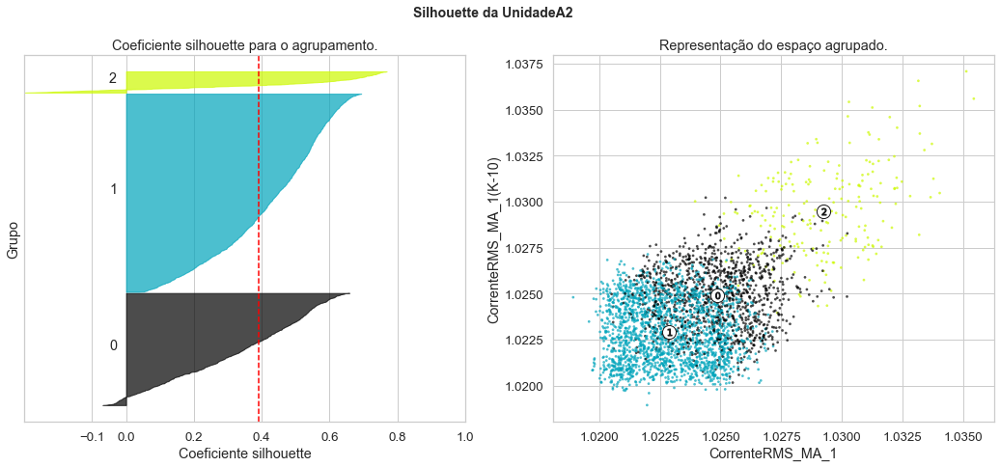

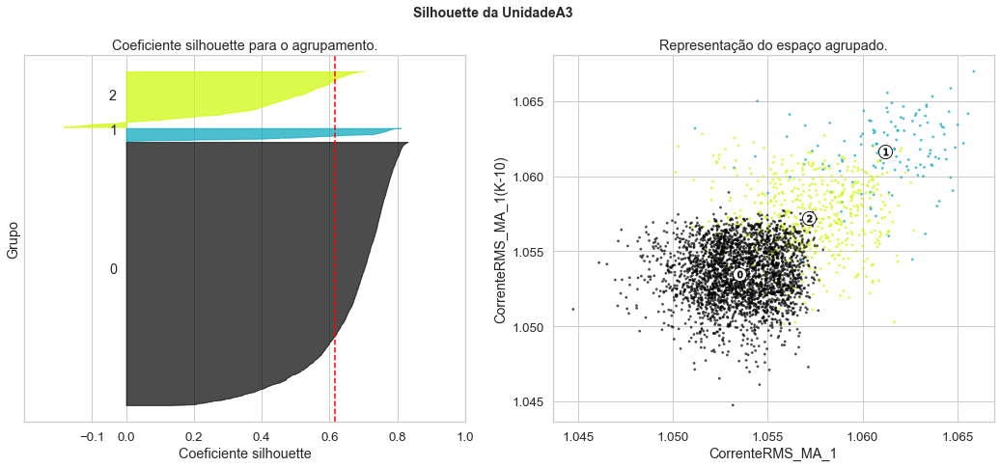

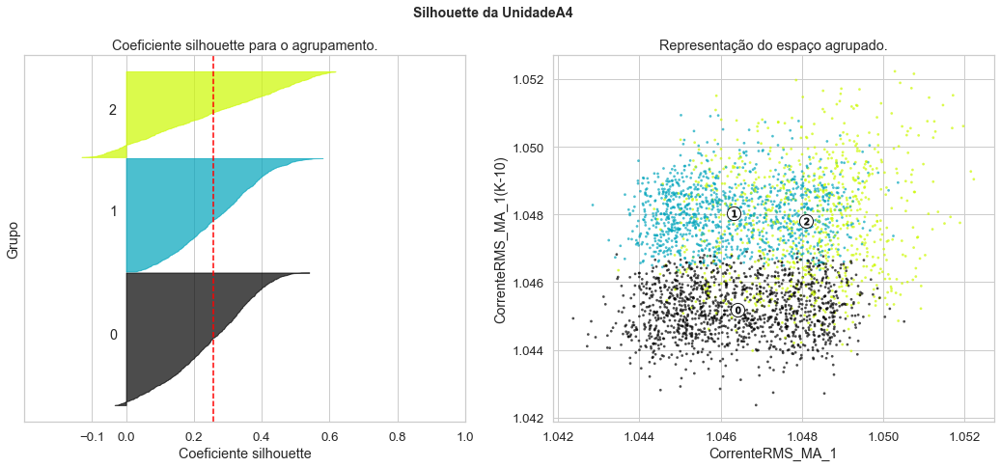

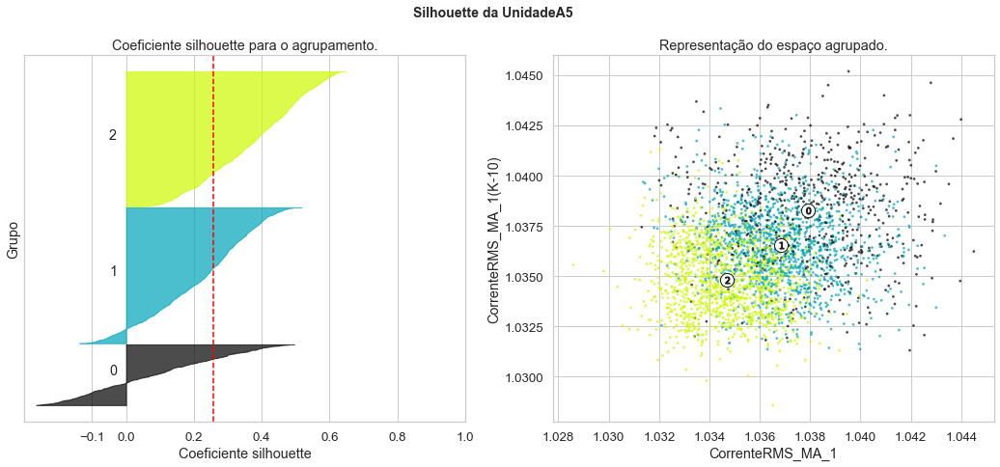

In [ ]:
# Para cada uma das unidades do modelo:
for j in range(4):
    if j == 0: # Unidade A2
        name_unidade = "A2"
        dados_tratados = aplica_tratamento(a2_1,a2_2,a2_3, [1, 5, 10, 30], N, [1, 10, 30], 20) # Aplica tratamento na amostra A2
    elif j == 1: # Unidade A3
        name_unidade = "A3"
        dados_tratados = aplica_tratamento(a3_1,a3_2,a3_3, [1, 5, 10, 30], N, [1, 10, 30], 20) # Aplica tratamento na amostra A3
    elif j == 2: # Unidade A4
        name_unidade = "A4"
        dados_tratados = aplica_tratamento(a4_1,a4_2,a4_3, [1, 5, 10, 30], N, [1, 10, 30], 20) # Aplica tratamento na amostra A4
    elif j == 3: # Unidade A5
        name_unidade = "A5"
        dados_tratados = aplica_tratamento(a5_1,a5_2,a5_3, [1, 5, 10, 30], N, [1, 10, 30], 20) # Aplica tratamento na amostra A5

    dados_tratados, modelo = dif_medias(dados_tratados,grandeza,"a_m" + str(M) +"_"+str(D),N,D,M) # Aplica k-means nos dados, retornando uma tabela com os preditores e respectivos clusters

    # Filtra apenas as grandezas de preditores utilizadas na clusterização
    dados_filtrados = pd.DataFrame({(grandeza + "_MA_" + str(M)):dados_tratados["CorrenteRMS_MA_"+ str(M)]})
    for n in range(1,N):
        # Adiciona as grandezas seguindo o padrão Nicolas de nomenclatura
        dados_filtrados[grandeza + "_MA_" + str(M) + "(K-" + str(n*D) + ")"] = dados_tratados[grandeza + "_MA_" + str(M) + "(K-" + str(n*D) + ")"] 
    dados_filtrados = dados_filtrados.dropna() # Exclui linhas com valores NaN (não são utilizados no k-means, e se referem a instantes anteriores ao início do ensaio)

    tabela_export = dados_filtrados.copy()
    tabela_export["Clusters"]= dados_tratados["Clusters"]

    cluster_labels = dados_tratados["Clusters"] # Cria variável apenas com as clusterizações
    
    fig,(ax1, ax2) = plt.subplots(1, 2) # Inicializa figura com subplots
    fig.set_size_inches(18, 7)
    ax1.set_xlim([-0.3, 1])

    
    #Calcula valores de silhouette
    valores_silhouette = silhouette_samples(dados_filtrados.to_numpy(), cluster_labels, metric="sqeuclidean")

    #Calcula média de silhouette
    silhouette_avg = silhouette_score(dados_filtrados.to_numpy(), cluster_labels, metric="sqeuclidean")
    print("A média de silhouette da unidade", name_unidade , "é :", silhouette_avg )

    # Plota a silhouette de cada cluster
    y_lower = 10
    for i in range(n_clusters):
        # Agrega os silhouettes por cluster
        valor_silhouette_unico = valores_silhouette[cluster_labels == i]

        valor_silhouette_unico.sort()

        size_cluster_i = valor_silhouette_unico.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            valor_silhouette_unico,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Coloca o label de cada cluster
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Calcula o ponto vertical para o início do plot do próximo cluster
        y_lower = y_upper + 10

    ax1.set_title("Coeficiente silhouette para o agrupamento.")
    ax1.set_xlabel("Coeficiente silhouette")
    ax1.set_ylabel("Grupo")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)

    if n_clusters>1:
        ax2.scatter(
            dados_filtrados[f'{grandeza}_MA_{M}'], dados_filtrados[f'{grandeza}_MA_{M}(K-{D})'], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
        )
    else:
        ax2.scatter(
            dados_filtrados[f'{grandeza}_MA_{M}'], np.zeros(len(dados_filtrados)), marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
        )

    # Labeling the clusters
    centers = modelo.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("Representação do espaço agrupado.")
    ax2.set_xlabel(f'{grandeza}_MA_{M}')
    ax2.set_ylabel(f'{grandeza}_MA_{M}(K-{D})')

    plt.suptitle(
        "Silhouette da Unidade" + name_unidade,
        fontsize=14,
        fontweight="bold",
    )

plt.show()